# Práctico 6 Procesamiento de Imágenes: Convolución


***

## Profesores:  
- Claudio Delrieux  

- Steven Martinez Vargas


## Alumno:  
- Leandro Bognino	36887290  



___

## Consigna:  

Implementar un aplicativo que levante una imagen en nivel de gris (o que la convierta a YIQ y retenga solo el Y) y aplique el filtrado por convolución para los siguientes filtros:
1. Pasabajos: Plano y Bartlett 3x3, 5x5, 7x7. Gaussiano 5x5 y 7x7.
2. Detectores de bordes: Laplaciano v4 y v8. Sobel las 8 orientaciones.
3. Pasabanda, pasaaltos de frecuencia de corte 0,2 y 0,4  
Respecto del “cierre” de la imagen cerca de los bordes, implementar la técnica no matemáticamente perfecta de “repetir” artificialmente filas o columnas cuando estas hagan falta. Por ejemplo, si el kernel es 3x3 y estoy en la primera columna, y no hay ninguna columna a la izquierda, entonces repito la primera columna como si estuviese en la imagen original. Otra opción es la conocida como padding en la cual adicionamos filas y columnas de ceros en los extremos de la imagen, similar al que les mostré para hacer que dos imágenes tengan el mismo tamaño.  
Deben mostrar el aplicativo que permita cargar o seleccionar la imagen y elegir de una lista el filtro a aplicar ver su resultado. Adicionalmente deben mostrar un plot con todos los filtros aplicados para la imagen de entrada. 


### Dependencias e inclusión de librerías

In [1]:
import numpy as np
import imageio as io
import matplotlib.pyplot as plt
import ipywidgets as widgets
from IPython.display import display
from skimage.transform import resize

### 0. Funciones de soporte desarrolladas en los trabajos previos

In [2]:
# Descargar, leer, normalizar la imagen.
def get_and_read_img (url, name=''):
  img = io.imread(url)
  img = np.clip(img/255.,0.,1.)
  #img = resize(img,(600,600))
  return img

# Mostrar Imagen
def show_img (img, size = (8,8)):
  plt.figure(figsize = size)
  plt.imshow(img)
  plt.show()

def show2_img (img1, img2, title, size = (30,30)):
  f, axarr = plt.subplots(1,2,figsize=size)
  axarr[0].set_title("Original")
  axarr[0].imshow(img1)
  axarr[1].set_title(title)
  axarr[1].imshow(img2)
  plt.show()

# RGB a YIQ
def rgb2yiq (img):
  RGB_2_YIQ_MATRIX = np.array([[ 0.299, 0.587, 0.114], 
                               [ 0.595716, -0.274453, -0.321263], 
                               [ 0.211456, -0.522591, 0.311135]])
  
  im_yiq =  np.copy(img)
  for i in range(len(img)):
    for j in range(len(img[0])):
        im_yiq[i][j] = RGB_2_YIQ_MATRIX.dot(img[i][j])

  im_yiq[:,:,0] = np.clip(im_yiq[:,:,0],0,1)
  im_yiq[:,:,1] = np.clip(im_yiq[:,:,1],-0.5957, 0.5957)
  im_yiq[:,:,2] = np.clip(im_yiq[:,:,2],-0.5226, 0.5226)

  return im_yiq

# YIQ a RGB
def yiq2rgb (img):
  YIQ_2_RGB_MATRIX = np.array([[1, 0.9663, 0.6210], 
                              [1, -0.2721, -0.6474], 
                              [1, -1.1070, 1.7046]])
  im_rgb =  np.copy(img)
  for i in range(len(img)):
    for j in range(len(img[0])):
        im_rgb[i][j] = np.clip(YIQ_2_RGB_MATRIX.dot(img[i][j]),0,1)

  return im_rgb

### 0.1 Funciones FFT - IFFT

In [3]:
def make_fft(image, offset):
  shape = image.shape
  if (len(shape) > 2): #aka rgb
    fft = np.fft.fftshift(np.fft.fft2(image[:, :, 0]))
  else:
    fft = np.fft.fftshift(np.fft.fft2(image))

  mag = np.uint8(np.floor(np.log(np.abs(fft)+ offset)))
  phase = np.angle(fft)
  return mag, phase

### 0.2 Visualización de los datos

In [4]:
def plot_fft(image,mag,phase):
  plt.set_cmap('gray')
  fig, ax = plt.subplots(1, 3, figsize=(30, 50))
  ax[0].imshow(image)
  ax[0].set_title('Imagen')
  ax[1].imshow(mag)
  ax[1].set_title('Magnitud')
  ax[2].imshow(phase)
  ax[2].set_title('Fase')
  plt.show()  

### 1. Carga de la imagen a procesar

<Figure size 432x288 with 0 Axes>

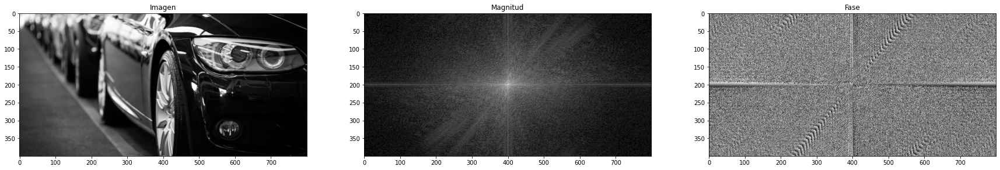

In [5]:
#@title Imágenes de Entrada: { run: "auto" }
dict_urls = {'Auto':'https://www.recambiooriginal.com/wp-content/uploads/2018/11/pintura_negra_coche_ventajas_inconvenientes_3-800x400.jpg',
             'Edificio':'https://s3-sa-east-1.amazonaws.com/modernabuenosaires/img/obras/galeria/888_1506021627.jpg',
             'Muralla':'https://upload.wikimedia.org/wikipedia/commons/thumb/2/23/The_Great_Wall_of_China_at_Jinshanling-edit.jpg/1200px-The_Great_Wall_of_China_at_Jinshanling-edit.jpg',
             'Senor':'https://akvis.com/img/examples/retoucher/man-photoshop/source.jpg'
            }

Imagen1 = 'Auto' #@param ["Auto","Edificio","Muralla","Senor"]
im = get_and_read_img(dict_urls[Imagen1])

mag, phase = make_fft(im,1.)

plot_fft(im, mag, phase)


### 2. Función de Filtrado

In [6]:
def filter_image(image, kernel):
    imagen_filtrada = np.copy(image)
    imagen_con_borde = np.pad(np.copy(image), pad_width=int(len(kernel)/2), mode='reflect')

    for i in range(len(image)):
        for j in range(len(image[0])):
            block = imagen_con_borde[i:i+len(kernel), j:j+len(kernel)]
            block = block* kernel
            block = block.sum() 
            if (kernel.sum() != 0):
                block = block / kernel.sum()
            if (block > 1):
                block = 1.
            if block < 0:
                block = 0.
            imagen_filtrada[i][j] = block

    return imagen_filtrada

### 3. Pasabajos: Pasabajos: Plano y Bartlett 3x3, 5x5, 7x7. Gaussiano 5x5 y 7x7.

In [7]:
def gkern(l=5, sig=1.):
    ax = np.linspace(-(l - 1) / 2., (l - 1) / 2., l)
    gauss = np.exp(-0.5 * np.square(ax) / np.square(sig))
    kernel = np.outer(gauss, gauss)
    return kernel / np.sum(kernel)

def bartletkern (l=5):
  column = [i+1 for i in range(l-2)]
  tail = column[0:-1]
  tail.reverse()
  column.extend(tail)
  column = np.array(column)
  kernel = np.outer(column,column.T)
  return kernel / np.sum(kernel)

def planokern(l=5):
  kernel = np.ones((l,l),np.float32)/(l*l)
  return kernel

In [8]:
Plano3x3 = planokern(3)
Plano5x5 = planokern(5)
Plano7x7 = planokern(7)

Bartlett3x3 = bartletkern(3)
Bartlett5x5 = bartletkern(5)
Bartlett7x7 = bartletkern(7)

Gaussiano5x5 = gkern(5)
Gaussiano7x7 = gkern(7)

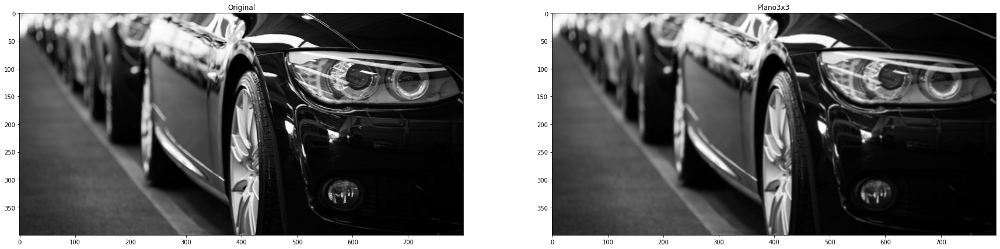

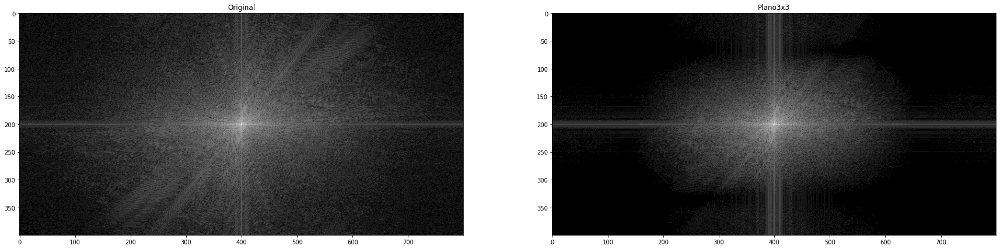

In [9]:
#@title Filtro Pasabajo a Aplicar: { run: "auto" }

Filtro = 'Plano3x3' #@param ["Plano3x3","Plano5x5","Plano7x7","Bartlett3x3","Bartlett5x5","Bartlett7x7","Gaussiano5x5","Gaussiano7x7"]

im_yiq = rgb2yiq(im)

im_transf = filter_image(im_yiq[:,:,0],eval(Filtro))

im_yiq[:,:,0] = im_transf
im_yiq[:,:,1] = im_yiq[:,:,1]
im_yiq[:,:,2] = im_yiq[:,:,2]

image_rgb =  yiq2rgb(im_yiq)

show2_img(im,image_rgb,Filtro)

mag1, phase1 = make_fft(image_rgb,1.)
show2_img(mag,mag1,Filtro)

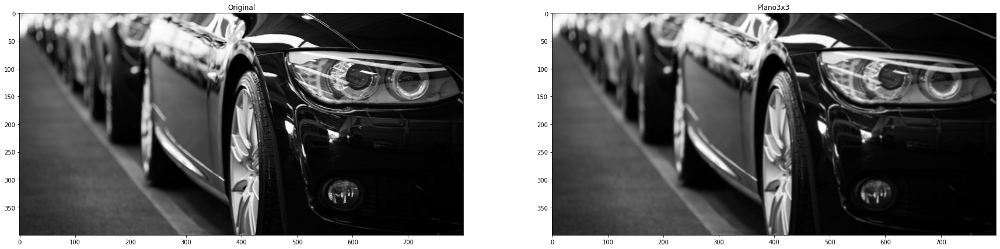

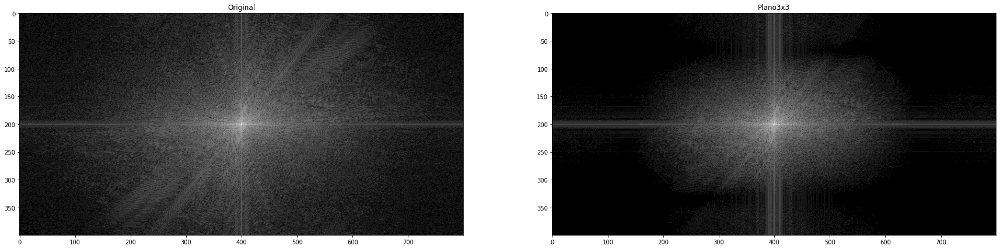

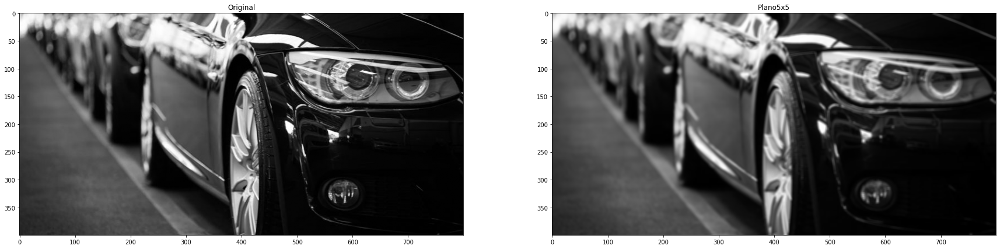

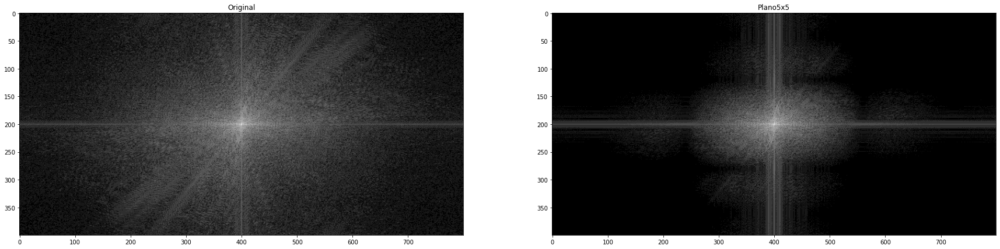

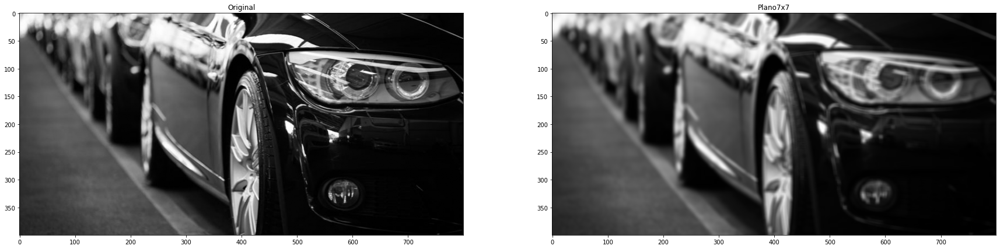

...

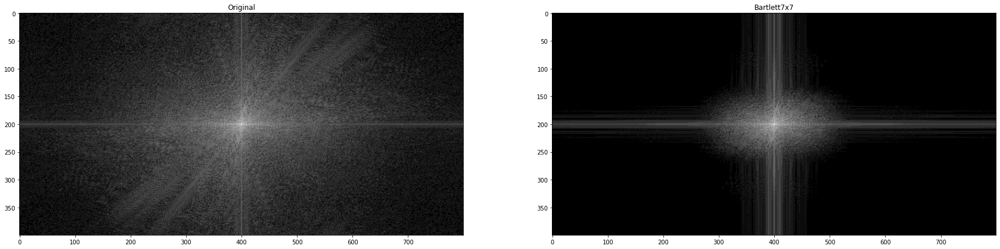

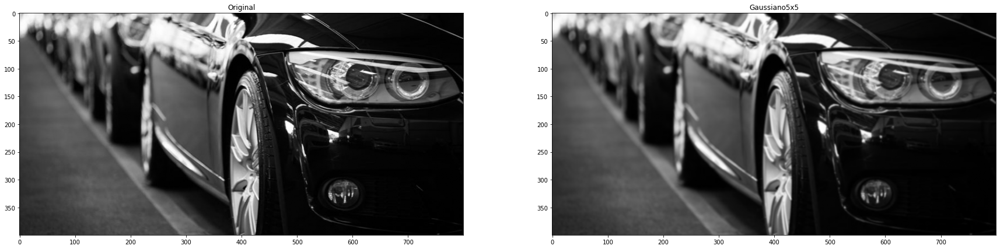

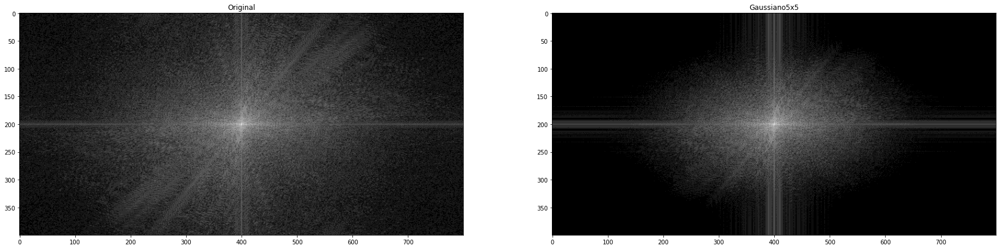

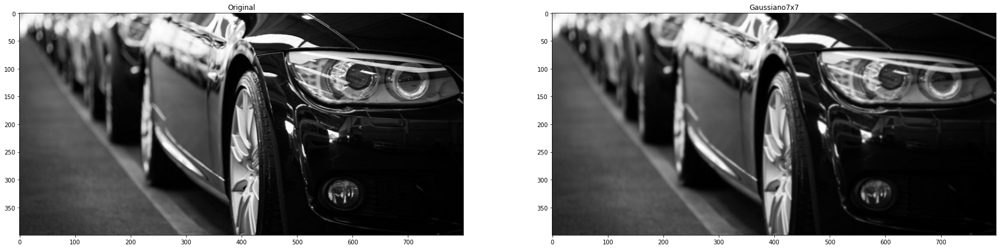

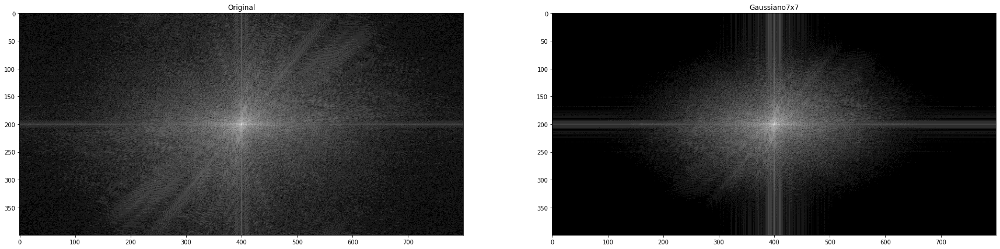

In [10]:
filters = ["Plano3x3","Plano5x5","Plano7x7","Bartlett3x3","Bartlett5x5","Bartlett7x7","Gaussiano5x5","Gaussiano7x7"]


for i in filters:
  im_yiq = rgb2yiq(im)
  im_transf = filter_image(im_yiq[:,:,0],eval(i))

  im_yiq[:,:,0] = im_transf
  im_yiq[:,:,1] = im_yiq[:,:,1]
  im_yiq[:,:,2] = im_yiq[:,:,2]
  image_rgb =  yiq2rgb(im_yiq)
  
  show2_img(im,image_rgb,i)
  mag1, phase1 = make_fft(image_rgb,1.)
  show2_img(mag,mag1,i)

Podemos observar que el kernel gaussiano y kernel se comportan mejor que el kernel plano. Siendo el kernel gaussiano un poco mejor que el Bartlett. Además, al cambiar el tamaño del kernel vemos que la zona de paso tiene mayor energía y la energía es menor en la zona de rechazo a medida que aumentamos el tamaño.

### 4. Detectores de bordes: Laplaciano 4 vecinos, Sobel 4 orientaciones

In [11]:
Laplacianov8 = np.array([[ -1, -1,-1], 
                          [ -1, 8, -1], 
                          [ -1, -1,-1]])

Laplacianov4 = np.array([ [  0, -1,  0], 
                          [ -1,  4, -1], 
                          [  0, -1,  0]])

Sobelh = np.array([[ -1, 0, 1], 
                   [ -2, 0, 2], 
                   [ -1, 0, 1]])

Sobelv = np.array([[ -1,-2, -1], 
                   [  0, 0,  0], 
                   [  1, 2,  1]])

Sobelh1 = np.array([[  1, 0, -1], 
                    [  2, 0, -2], 
                    [  1, 0, -1]])

Sobelv1 = np.array([[ 1, 2, 1], 
                   [  0, 0, 0], 
                   [ -1,-2,-1]])

Sobeld1 = np.array([[ -2, -1, 0], 
                    [ -1,  0, 1], 
                    [  0,  1, 2]])

Sobeld2 = np.array([[ -2, -1, 0], 
                    [ -1,  0, 1], 
                    [  0,  1, 2]])

Sobeld3 = np.array([[  2, 1, 0], 
                    [  1, 0,-1], 
                    [  0,-1,-2]])

Sobeld4 = np.array([[  2,  1,   0], 
                    [  1,  0,  -1], 
                    [  0,  -1, -2]])

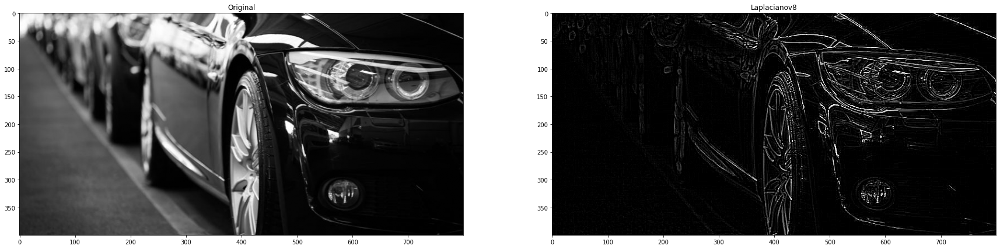

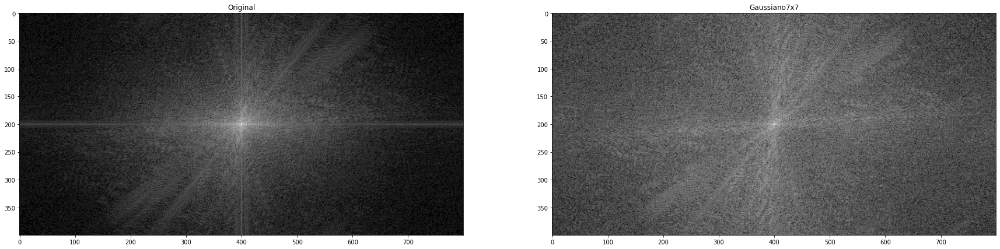

In [12]:
#@title Filtro Detector de Bordes a Aplicar: { run: "auto" }

Filtro = 'Laplacianov8' #@param ["Laplacianov4","Laplacianov8","Sobelh","Sobelv","Sobelh1","Sobelv1","Sobeld1","Sobeld2","Sobeld3","Sobeld4"]

im_yiq = rgb2yiq(im)
im_transf = filter_image(im_yiq[:,:,0],eval(Filtro))

im_yiq[:,:,0] = im_transf
im_yiq[:,:,1] = im_yiq[:,:,1]
im_yiq[:,:,2] = im_yiq[:,:,2]
image_rgb =  yiq2rgb(im_yiq)

#image_rgb_plano = Image.fromarray(np.uint8(image_rgb*255))
show2_img(im,image_rgb,Filtro)

mag1, phase1 = make_fft(image_rgb,1.)
show2_img(mag,mag1,Filtro)

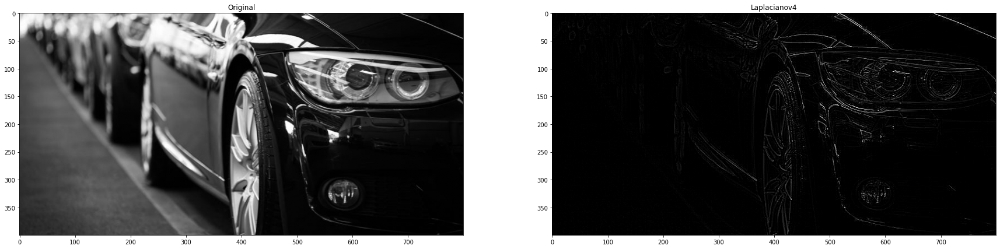

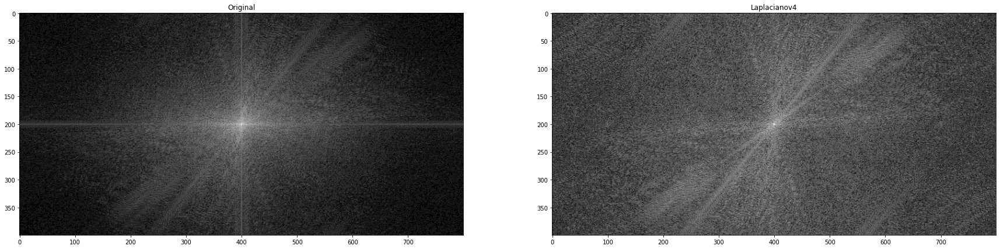

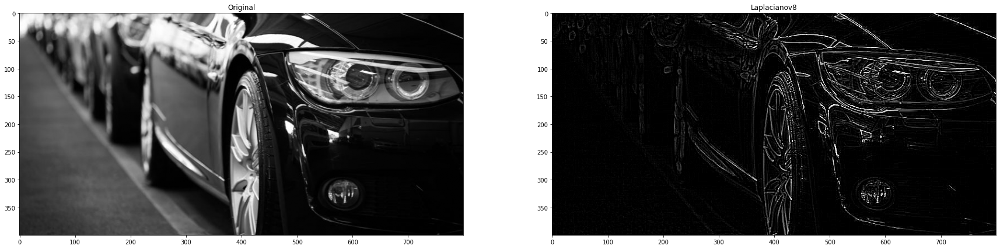

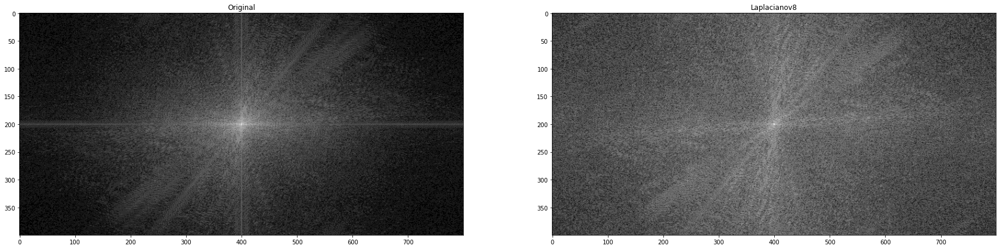

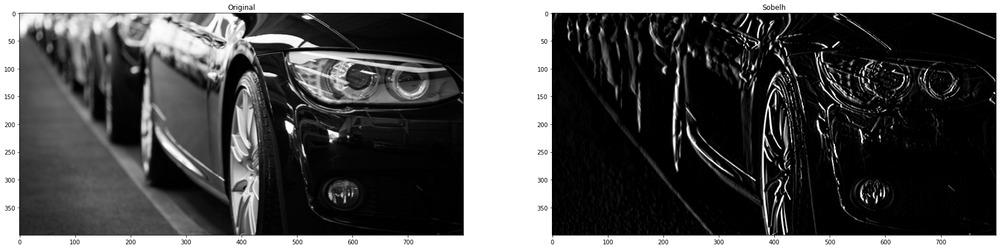

...

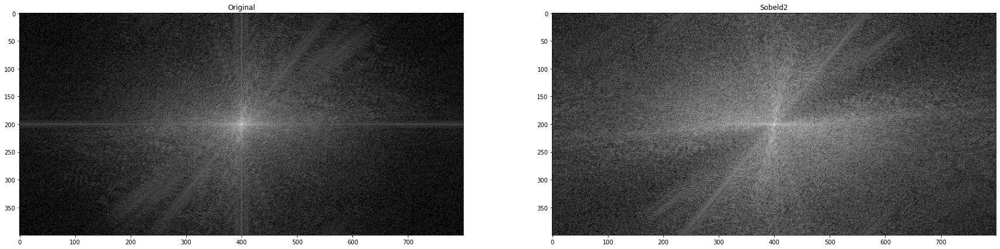

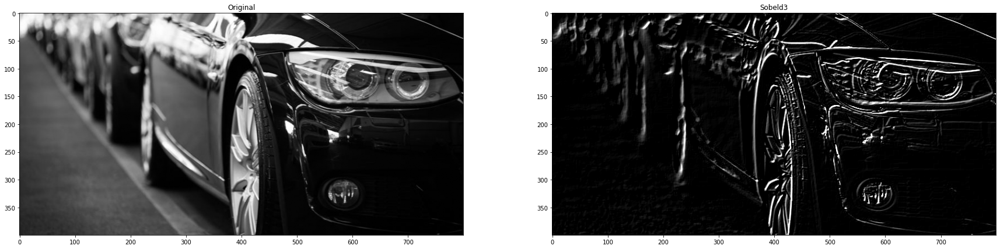

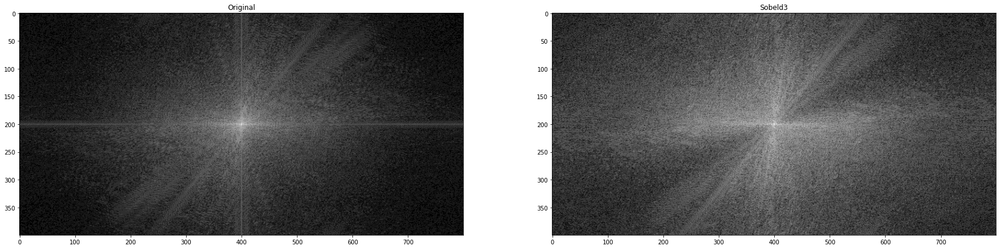

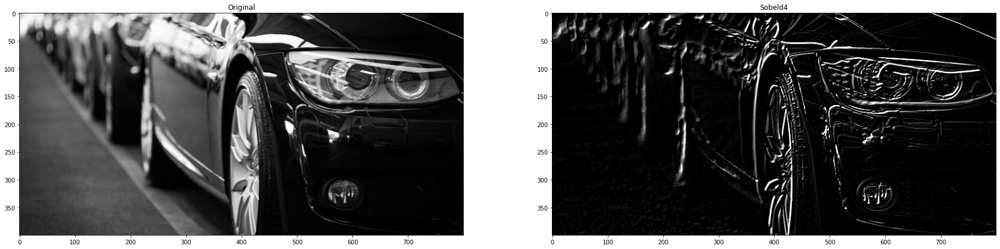

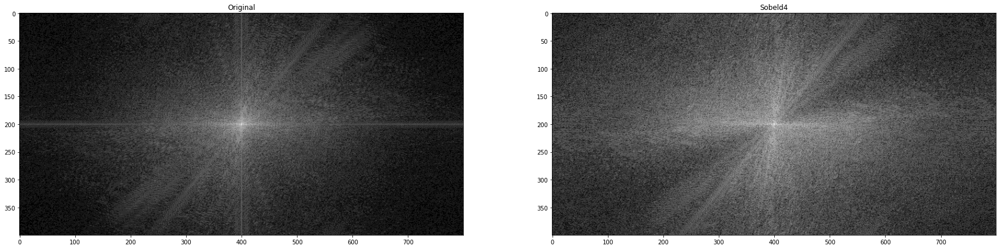

In [13]:
filters = ["Laplacianov4","Laplacianov8","Sobelh","Sobelv","Sobelh1","Sobelv1","Sobeld1","Sobeld2","Sobeld3","Sobeld4"]


for i in filters:
  im_yiq = rgb2yiq(im)
  im_transf = filter_image(im_yiq[:,:,0],eval(i))

  im_yiq[:,:,0] = im_transf
  im_yiq[:,:,1] = im_yiq[:,:,1]
  im_yiq[:,:,2] = im_yiq[:,:,2]
  image_rgb =  yiq2rgb(im_yiq)
  
  show2_img(im,image_rgb,i)
  mag1, phase1 = make_fft(image_rgb,1.)
  show2_img(mag,mag1,i)

En los filtros Sobel vemos que según la orientación que tomamos, se visibiliza la energía en el espectro de frecuencias relacionada a la orientación del kernel. Por ejemplo, en el sobel horizontal, vemos más claramente la línea horizontal del espectro. En el caso del filtro laplaciano, vemos que las frecuencias en la zona baja se atenúan y las frecuencias altas se incrementan. En el dominio espacial de la imagen, podemos observar que todos resaltan los bordes. Particularmente en los sobel, los bordes relacionados a su orientación.

### 5. Pasabanda (DOG: Difference of Gaussians)

In [14]:
kernel_Gaussiano_3x3 = np.array([[ 0,    0,    0,    0, 0], 
                                 [ 0, 1/16, 2/16, 1/16, 0], 
                                 [ 0, 2/16, 4/16, 2/16, 0], 
                                 [ 0, 1/16, 2/16, 1/16, 0], 
                                 [ 0,    0,    0,    0, 0]])
 
kernel_Gaussiano_5x5 = np.array([[ 1/256,  4/256,  6/256,  4/256,1/256], 
                                 [ 4/256, 16/256, 24/256, 16/256, 4/256], 
                                 [ 7/256, 24/256, 36/256, 24/256, 7/256], 
                                 [ 4/256, 16/256, 24/256, 16/256, 4/256], 
                                 [ 1/256,  4/256,  7/256,  4/256, 1/256]])

Pasabanda = kernel_Gaussiano_5x5 - kernel_Gaussiano_3x3

In [15]:
# Filtro Pasabanda

im_yiq = rgb2yiq(im)
im_transf = filter_image(im_yiq[:,:,0],Pasabanda)

im_yiq[:,:,0] = im_transf
im_yiq[:,:,1] = im_yiq[:,:,1]
im_yiq[:,:,2] = im_yiq[:,:,2]
image_rgb = yiq2rgb(im_yiq)


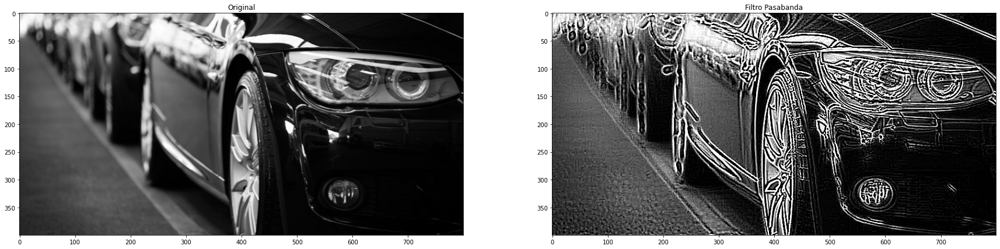

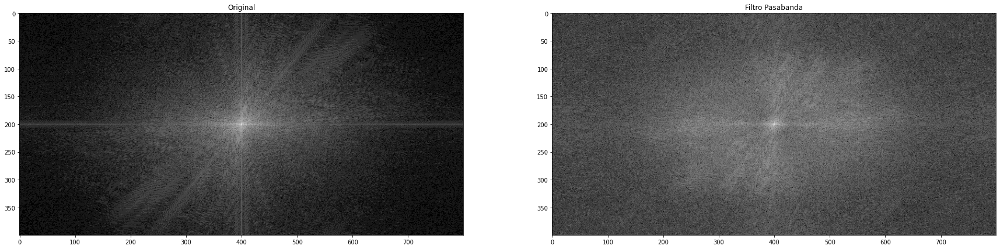

In [16]:
show2_img(im,image_rgb,"Filtro Pasabanda")
mag1, phase1 = make_fft(image_rgb,1.)
show2_img(mag,mag1,"Filtro Pasabanda")


En el filtro pasabanda vemos como se resaltan frecuencias en un rango (como un aro) y se atenúan las frecuencias más bajas.

## 6. Pasa altos frecuencia de corte 0.2 y 0.4

In [17]:
def pasa_alto (fc = 0.2):
    if (fc == 0.2):
      kernel_1d = np.array([1., -4., 6., -4., 1.])
    else:
      kernel_1d = np.array([-1., -4., 10., -4., -1.])
    kernel = np.outer(kernel_1d, kernel_1d)
    if (np.sum(kernel) == 0.):
      return kernel
    else:
      return kernel / np.sum(kernel)

PasaAlto02 = pasa_alto()
PasaAlto04 = pasa_alto(0.4)

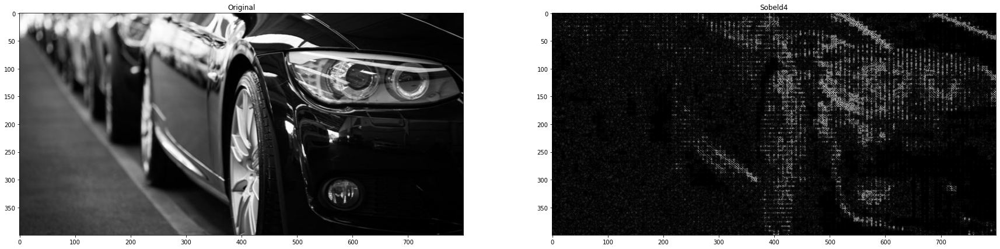

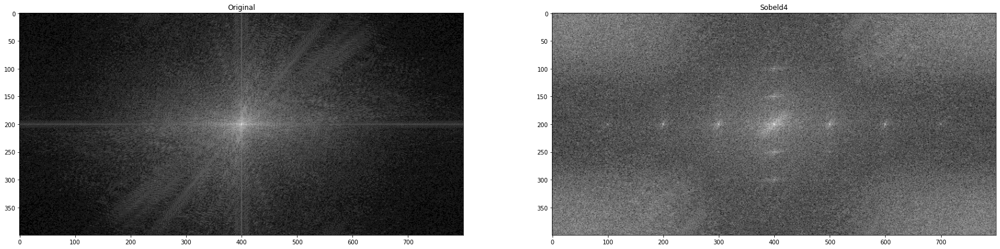

In [18]:
#@title Filtro Pasa Altos a Aplicar: { run: "auto" }

Filtro = 'PasaAlto02' #@param ["PasaAlto02","PasaAlto04"]

im_yiq = rgb2yiq(im)
im_transf = filter_image(im_yiq[:,:,0],eval(Filtro))

im_yiq[:,:,0] = im_transf
im_yiq[:,:,1] = im_yiq[:,:,1]
im_yiq[:,:,2] = im_yiq[:,:,2]
image_rgb =  yiq2rgb(im_yiq)

#image_rgb_plano = Image.fromarray(np.uint8(image_rgb*255))
show2_img(im,image_rgb,i)

mag1, phase1 = make_fft(image_rgb,1.)
show2_img(mag,mag1,i)

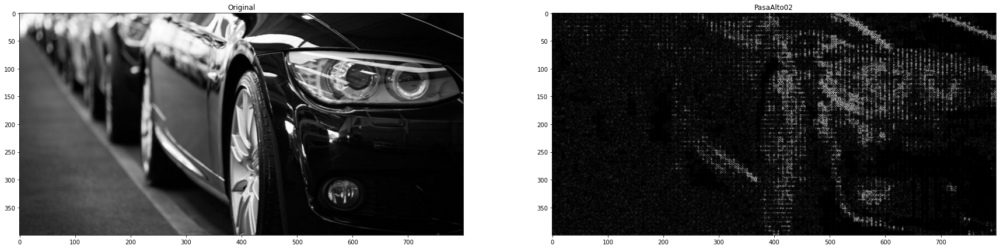

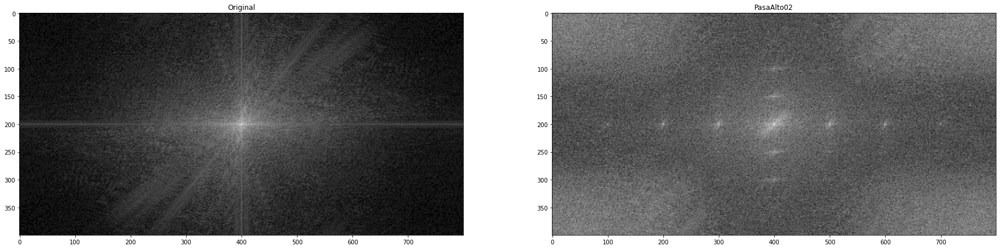

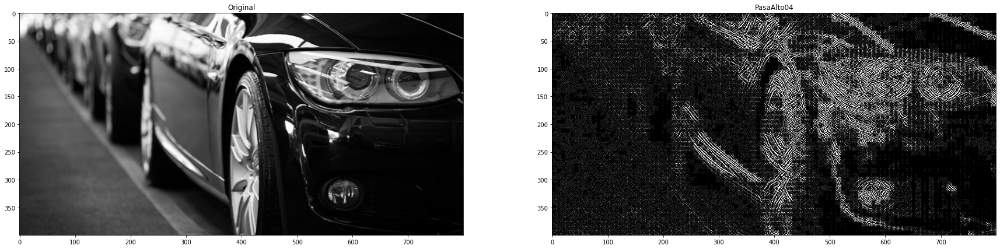

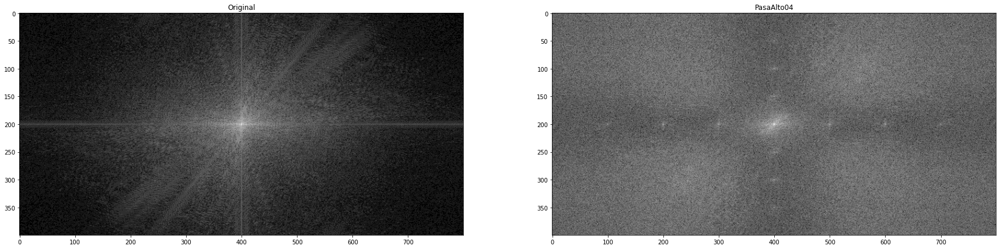

In [19]:
filters = ["PasaAlto02","PasaAlto04"]


for i in filters:
  im_yiq = rgb2yiq(im)
  im_transf = filter_image(im_yiq[:,:,0],eval(i))

  im_yiq[:,:,0] = im_transf
  im_yiq[:,:,1] = im_yiq[:,:,1]
  im_yiq[:,:,2] = im_yiq[:,:,2]
  image_rgb =  yiq2rgb(im_yiq)
  
  show2_img(im,image_rgb,i)
  mag1, phase1 = make_fft(image_rgb,1.)
  show2_img(mag,mag1,i)

Podemos ver en los filtros pasa altos que las frecuencias bajas se atenúan, en el centro se ve menor cantidad de energía. Entre los filtros, la frecuencia de corte se hace evidente en el área de la zona de atenuación de cada caso.

## Conclusiones

Cada filtro tiene aplicaciones diferentes y respuestas diferentes que se ven claramente en el dominio de la frecuencia. En este tema también se profundizó en la creación de los kernels y qué valores tiene que tener para cumplir determinado filtrado específico y la frecuencia de corte requerida. Tambíen se vio de forma práctica las limitaciones al tener una cantidad limitada de coeficientes para representar la función específica en el kernel con tamaño limitado